<a href="https://colab.research.google.com/github/michaeldouglas/mba_IA_ML-proj_int-grupo_b/blob/main/Python/Trabalho_DimDim/Inadimplencia_Clientes.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip 

In [ ]:
!pip install biokit scikit-optimize scikit-plot;

In [ ]:
!pip install pyjanitor

### Sobre o trabalho

A DinDin Agora está acompanhando um crescimento de inadimplência entre seus
clientes e solicita a consultoria para desenvolver uma análise de inadimplência.

A partir do modelo escolhido vocês irão prever quais clientes tem propensão a ficar inadimplente na base test.

<center>

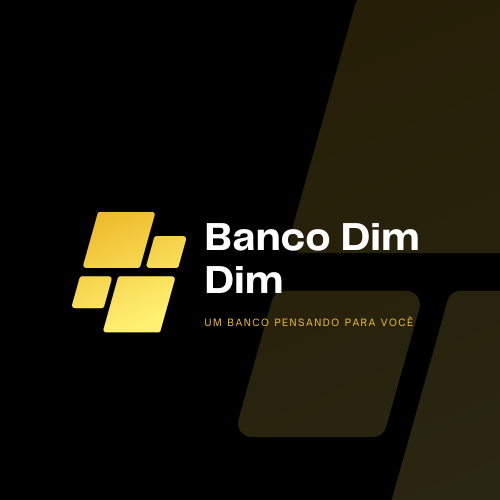

</center>

## Contextualização do Problema

Neste problema, o objetivo é identificar se o cliente da Dim Dim não cumprirá com suas obrigações financeiras e deixará de pagar a sua fatura do Cartão de Crédito (`default`).

In [4]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import sklearn
from sklearn.linear_model import LogisticRegression 
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier,export_graphviz
from sklearn.tree import plot_tree
from sklearn import preprocessing
from sklearn import metrics 
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix 
from sklearn.metrics import roc_curve
from sklearn.model_selection import cross_val_score

#definindo padrão para o Seaborn
sns.set_style()

In [5]:
Base_Inad = pd.read_csv("Clientes.csv", sep=",")

print("Total number of transactions: "+ str(Base_Inad.shape[0]))
Base_Inad.head(5)

Total number of transactions: 31727


,ids,target_default,score_1,score_2,score_3,score_4,score_5,score_6,risk_rate,last_amount_borrowed,...,external_data_provider_fraud_score,lat_lon,marketing_channel,profile_phone_number,reported_income,shipping_state,shipping_zip_code,profile_tags,user_agent,target_fraud
0,343b7e7b-2cf8-e508-b8fd-0a0285af30aa,False,1Rk8w4Ucd5yR3KcqZzLdow==,IOVu8au3ISbo6+zmfnYwMg==,350.0,101.800832,0.259555,108.427273,0.40,25033.92,...,645.0,"(-29.151545708122246, -51.1386461804385)",Invite-email,514-9840782,57849.0,BR-MT,17528.0,"{'tags': ['n19', 'n8']}",Mozilla/5.0 (Linux; Android 6.0.1; SGP771 Buil...,NaN
1,bc2c7502-bbad-0f8c-39c3-94e881967124,False,DGCQep2AE5QRkNCshIAlFQ==,SaamrHMo23l/3TwXOWgVzw==,370.0,97.062615,0.942655,92.002546,0.24,NaN,...,243.0,"(-19.687710705798963, -47.94151536525154)",Radio-commercial,251-3659293,4902.0,BR-RS,40933.0,"{'tags': ['n6', 'n7', 'nim']}",Mozilla/5.0 (Linux; Android 5.0.2; SAMSUNG SM-...,NaN
2,669630dd-2e6a-0396-84bf-455e5009c922,True,DGCQep2AE5QRkNCshIAlFQ==,Fv28Bz0YRTVAT5kl1bAV6g==,360.0,100.027073,0.351918,112.892453,0.29,7207.92,...,65.0,"(-28.748023890412284, -51.867279334353995)",Waiting-list,230-6097993,163679.0,BR-RR,50985.0,"{'tags': ['n0', 'n17', 'nim', 'da']}",Mozilla/5.0 (Linux; Android 6.0.1; SGP771 Buil...,NaN
3,d235609e-b6cb-0ccc-a329-d4f12e7ebdc1,False,1Rk8w4Ucd5yR3KcqZzLdow==,dCm9hFKfdRm7ej3jW+gyxw==,510.0,101.599485,0.987673,94.902491,0.32,NaN,...,815.0,"(-17.520650158450454, -39.75801139933186)",Waiting-list,261-3543751,1086.0,BR-RN,37825.0,{'tags': ['n4']},Mozilla/5.0 (Linux; Android 6.0; HTC One X10 B...,NaN
4,9e0eb880-e8f4-3faa-67d8-f5cdd2b3932b,False,8k8UDR4Yx0qasAjkGrUZLw==,+CxEO4w7jv3QPI/BQbyqAA==,500.0,98.474289,0.532539,118.126207,0.18,NaN,...,320.0,"(-16.574259446978008, -39.90990074785962)",Invite-email,102-3660162,198618.0,BR-MT,52827.0,"{'tags': ['pro+aty', 'n19', 'da', 'b19']}",Mozilla/5.0 (Linux; Android 7.0; Pixel C Build...,NaN


In [6]:
Base_Inad.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31727 entries, 0 to 31726
Data columns (total 43 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   ids                                               31727 non-null  object 
 1   target_default                                    29449 non-null  object 
 2   score_1                                           31352 non-null  object 
 3   score_2                                           31352 non-null  object 
 4   score_3                                           31352 non-null  float64
 5   score_4                                           31727 non-null  float64
 6   score_5                                           31727 non-null  float64
 7   score_6                                           31727 non-null  float64
 8   risk_rate                                         31352 non-null  float64
 9   last_amount_borro

In [7]:
pd.DataFrame(zip(Base_Inad.isnull().sum(), Base_Inad.isnull().sum()/len(Base_Inad)), columns=['Count', 'Proportion'], index=Base_Inad.columns)

,Count,Proportion
ids,0,0.000000
target_default,2278,0.071800
score_1,375,0.011820
score_2,375,0.011820
score_3,375,0.011820
score_4,0,0.000000
score_5,0,0.000000
score_6,0,0.000000
risk_rate,375,0.011820
last_amount_borrowed,21071,0.664135


### Dimensões do nosso DataSet

Decidimos realizar uma inspeção e verificar as dimensões e estrutura geral dos nossos dados.

In [8]:
print("Entradas ou linhas: {}".format(Base_Inad.shape[0]))
print("Colunas ou variáveis: {}".format(Base_Inad.shape[1]))

Entradas ou linhas: 31727
Colunas ou variáveis: 43


Nosso dataset possui 45.000 linhas e 43 variáveis distintas.

In [9]:
print(list(Base_Inad))

['ids', 'target_default', 'score_1', 'score_2', 'score_3', 'score_4', 'score_5', 'score_6', 'risk_rate', 'last_amount_borrowed', 'last_borrowed_in_months', 'credit_limit', 'reason', 'income', 'facebook_profile', 'state', 'zip', 'channel', 'job_name', 'real_state', 'ok_since', 'n_bankruptcies', 'n_defaulted_loans', 'n_accounts', 'n_issues', 'application_time_applied', 'application_time_in_funnel', 'email', 'external_data_provider_credit_checks_last_2_year', 'external_data_provider_credit_checks_last_month', 'external_data_provider_credit_checks_last_year', 'external_data_provider_email_seen_before', 'external_data_provider_first_name', 'external_data_provider_fraud_score', 'lat_lon', 'marketing_channel', 'profile_phone_number', 'reported_income', 'shipping_state', 'shipping_zip_code', 'profile_tags', 'user_agent', 'target_fraud']


### Dicionário dos dados

- A coluna `ids` é anônima e representa o identificador único do cliente na Dim Dim.

- A coluna `target_default` é o nosso **alvo**. Essa coluna representa no dataset se o cliente cumpriu ou não com as obrigações junto a Dim Dim.

- As colunas `score_1` e `score_2` estão codificadas de alguma forma.  As colunas `score_3`, `score_4`, `score_5` e `score_6` são numéricas. Essas variáveis classificam o cliente quanto a pontuação de crédito.

- existem outras variáveis que apresentam algum tipo de codificação, como ['reason', 'state', 'zip', 'channel', 'job_name', 'real_state'] que estão codificadas.

- A coluna `lat_lon` está em formato string contendo uma tupla com as coordenadas. A coluna `shipping_zip_code` é referente ao CEP do canal de comunicação indicado pelo cliente, assim como a coluna `zip` provavelmente representa o CEP.

- As colunas `last_amount_borrowed`, `last_borrowed_in_months`, `credit_limit` indicam a existência de empréstimos, quando o último empréstimo foi realizado e o limite de crédito para o cliente.


In [10]:
Base_Inad.describe()

,score_3,score_4,score_5,score_6,risk_rate,last_amount_borrowed,last_borrowed_in_months,credit_limit,income,ok_since,...,n_accounts,n_issues,application_time_in_funnel,external_data_provider_credit_checks_last_2_year,external_data_provider_credit_checks_last_month,external_data_provider_credit_checks_last_year,external_data_provider_email_seen_before,external_data_provider_fraud_score,reported_income,shipping_zip_code
count,31352.000000,31727.000000,31727.000000,31727.000000,31352.000000,10656.000000,10656.000000,21948.000000,3.135200e+04,13013.000000,...,31352.000000,23541.000000,31726.000000,15781.0,31726.000000,21092.000000,30135.000000,31726.000000,31726.00,31726.000000
mean,347.907311,100.015013,0.499235,99.876321,0.297198,13748.675483,41.743243,34190.060689,7.169978e+04,35.017214,...,10.694629,11.068986,247.285980,0.0,1.503940,0.504646,12.736054,499.297296,inf,33903.600801
std,110.844995,3.184408,0.287733,10.016941,0.102004,8087.319630,10.240256,36297.600925,5.430801e+04,21.610706,...,4.600268,4.608201,146.250302,0.0,1.113695,0.499990,125.419064,288.138623,NaN,12685.067577
min,20.000000,87.119759,0.000064,60.663039,0.000000,1011.490000,36.000000,0.000000,4.821180e+03,0.000000,...,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,-999.000000,0.000000,410.00,12002.000000
25%,270.000000,97.868109,0.252431,93.181791,0.220000,7515.890000,36.000000,10033.750000,4.501389e+04,17.000000,...,7.000000,8.000000,120.000000,0.0,1.000000,0.000000,11.000000,249.000000,51009.25,22937.250000
50%,340.000000,100.016765,0.499860,99.902250,0.290000,12022.290000,36.000000,25465.000000,6.201070e+04,32.000000,...,10.000000,10.000000,247.000000,0.0,2.000000,1.000000,27.000000,502.000000,101520.50,33838.000000
75%,420.000000,102.163862,0.746892,106.553718,0.360000,19133.357500,36.000000,46975.250000,8.601789e+04,50.000000,...,13.000000,14.000000,375.000000,0.0,2.000000,1.000000,43.000000,746.000000,151442.00,44870.500000
max,990.000000,113.978234,0.999973,142.192400,0.900000,35059.600000,60.000000,448269.000000,5.000028e+06,141.000000,...,49.000000,49.000000,500.000000,0.0,3.000000,1.000000,59.000000,1000.000000,inf,56000.000000


### Resumo estatístico

- A coluna `external_data_provider_credit_checks_last_2_year` possui praticamente metade dos valores ausentes e valores máximo, mínimos e desvio padrão igual a 0 (zero), portanto não será útil para nossas validações.

- A coluna `external_data_provider_email_seen_before` possui um valor -999 e irá distorcer as análises futuras.

- A coluna `reported_income` possui valores infinitos, pelo rótulo da coluna podemos inferir que representa os valores informados de recebíveis do cliente.

No futuro em nossos ajustes poderemos substituir esse outlier pela mediana dos valores.

A seguir vamos verificar os tipos das variáveis.

In [11]:
Base_Inad.dtypes

ids                                                  object
target_default                                       object
score_1                                              object
score_2                                              object
score_3                                             float64
score_4                                             float64
score_5                                             float64
score_6                                             float64
risk_rate                                           float64
last_amount_borrowed                                float64
last_borrowed_in_months                             float64
credit_limit                                        float64
reason                                               object
income                                              float64
facebook_profile                                     object
state                                                object
zip                                     

### Eliminação das entradas Nan

Vamos remover os valores Nan do nosso vetor alvo, fizemos isso para evitar problemas em nosso modelo no futuro.

In [12]:
Base_Inad.dropna(subset=['target_default'], inplace=True)

### Proporção de inadimplentes

Resolvemos criar um subplot para verificar o total de inadimplentes da base de forma gráfica.

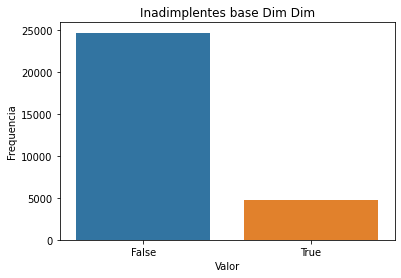

In [13]:
fig, ax = plt.subplots()
sns.countplot(x='target_default', data=Base_Inad, ax=ax)
ax.set_title("Inadimplentes base Dim Dim")
ax.set_xlabel("Valor")
ax.set_ylabel("Frequencia")
plt.show()
plt.close()

### Balanceamento das classes 

Vamos realizar uma análise e verificar o total de positivos e negativos que possuímos em nossa variável target.

In [14]:
neg, pos = np.bincount(Base_Inad.target_default)
total = neg + pos
print('Amostas:\n    Total: {}\n    Positivos: {} ({:.2f}% do total)\n'.format(
    total, pos, 100 * pos / total))

Amostas:
    Total: 29449
    Positivos: 4741 (16.10% do total)



Possuímos na base um total de 15.96% de positivos.

### Preparação dos dados

Podemos já observar algumas questões na base da Dim Dim e agora decidimos preosseguir com o tratamento e limpeza dos dados da base. Porém antes tomamos a decisão de realizar uma cópia do DataFrame original para a base: `dimdim_clean` 

In [15]:
dimdim_clean = Base_Inad.copy()

### Remoção de colunas

Resolvemos remover algumas colunas que não faziam sentido para a nossa análise de risco.

In [16]:
dimdim_clean.drop(labels=['ids', 'target_fraud', 
                          'external_data_provider_credit_checks_last_2_year', 
                          'channel'], axis=1, inplace=True )

A variável `reported_income` possui valores do tipo inf e isso pode ser um problema para o nosso modelo no futuro e por esse motivo resolvemos realizar uma substituição dos valores.

In [17]:
dimdim_clean['reported_income'] = dimdim_clean['reported_income'].replace(np.inf, np.nan)

A variável `external_data_provider_email_seen_before` possui valores do tipo -999 e isso pode ser um problema para o nosso modelo no futuro e por esse motivo resolvemos realizar uma substituição dos valores.

In [18]:
dimdim_clean.loc[dimdim_clean['external_data_provider_email_seen_before'] == -999, 'external_data_provider_email_seen_before']=np.nan

Resolvemos remover algumas variáveis que pareciam não fazer sentido para a nossa análise de clientes inadimplentes

In [19]:
dimdim_clean.drop(labels=['reason', 'job_name', 'external_data_provider_first_name',
            'lat_lon', 'shipping_zip_code', 'user_agent', 'profile_tags',
            'application_time_applied', 'email', 'marketing_channel',
            'profile_phone_number', 'shipping_state'], axis=1, inplace=True)

In [20]:
dimdim_clean.head()

,target_default,score_1,score_2,score_3,score_4,score_5,score_6,risk_rate,last_amount_borrowed,last_borrowed_in_months,...,n_bankruptcies,n_defaulted_loans,n_accounts,n_issues,application_time_in_funnel,external_data_provider_credit_checks_last_month,external_data_provider_credit_checks_last_year,external_data_provider_email_seen_before,external_data_provider_fraud_score,reported_income
0,False,1Rk8w4Ucd5yR3KcqZzLdow==,IOVu8au3ISbo6+zmfnYwMg==,350.0,101.800832,0.259555,108.427273,0.40,25033.92,36.0,...,0.0,0.0,18.0,18.0,444.0,2.0,0.0,51.0,645.0,57849.0
1,False,DGCQep2AE5QRkNCshIAlFQ==,SaamrHMo23l/3TwXOWgVzw==,370.0,97.062615,0.942655,92.002546,0.24,NaN,NaN,...,0.0,0.0,14.0,14.0,346.0,1.0,0.0,17.0,243.0,4902.0
2,True,DGCQep2AE5QRkNCshIAlFQ==,Fv28Bz0YRTVAT5kl1bAV6g==,360.0,100.027073,0.351918,112.892453,0.29,7207.92,36.0,...,0.0,0.0,10.0,NaN,6.0,2.0,NaN,9.0,65.0,163679.0
3,False,1Rk8w4Ucd5yR3KcqZzLdow==,dCm9hFKfdRm7ej3jW+gyxw==,510.0,101.599485,0.987673,94.902491,0.32,NaN,NaN,...,1.0,0.0,19.0,19.0,406.0,3.0,NaN,38.0,815.0,1086.0
4,False,8k8UDR4Yx0qasAjkGrUZLw==,+CxEO4w7jv3QPI/BQbyqAA==,500.0,98.474289,0.532539,118.126207,0.18,NaN,NaN,...,0.0,0.0,11.0,NaN,240.0,2.0,1.0,46.0,320.0,198618.0


Plot do gráfico de dispersão das variáveis `Income` e `Limite de Crédito`

[]

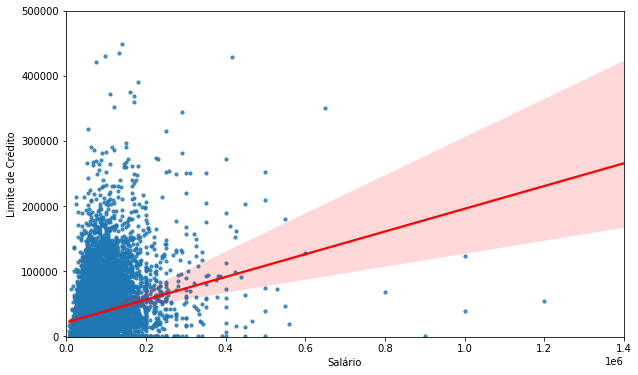

In [21]:
fig, ax = plt.subplots(figsize=(10,6))

ax.set_xlim(left=-1000,right=1400000)
ax.set_ylim(bottom=-1000,top=500000)
sns.regplot(x='income', y='credit_limit', scatter_kws={"s": 10}, 
            line_kws={"color": "red"}, data=dimdim_clean, ax=ax);
ax.set_ylabel('Limite de Crédito')
ax.set_xlabel('Salário')
ax.plot()

Com este gráfico nós podemos perceber que ao `salário` aumentar o `limite de crédito` também é aumentado, ou seja, quanto mais sálario mais limite de crédito a Dim Dim libera.

### Complementação dos dados ausentes

Iremos preencher as variáveis:

 - **last_amount_borrowed**: Preenchemos com 0;
 - **last_borrowed_in_months**: Preenchemos com 0;
 - **n_issues**:  Preenchemos com 0;
 - As outras colunas **numéricas** iremos preencher com a mediana dos valores;
 - As outras colunas **categóricas** iremos preencher com os dados mais frequentes.

In [22]:
from sklearn.impute import SimpleImputer ## Lib do sklearn para imputar dados

In [23]:
numericas = dimdim_clean.select_dtypes(exclude='object').columns # Obtemos as variáveis numericas
categoricas = dimdim_clean.select_dtypes(include='object').columns # Obtemos as variáveis categoricas

In [24]:
dimdim_clean.last_amount_borrowed.fillna(value=0, inplace=True) # Preenche com 0
dimdim_clean.last_borrowed_in_months.fillna(value=0, inplace=True) # Preenche com 0
dimdim_clean.n_issues.fillna(value=0, inplace=True) # Preenche com 0

Preenchendo as variáveis numéricas

In [25]:
imputer = SimpleImputer(missing_values=np.nan, strategy='median')
imputer = imputer.fit(dimdim_clean.loc[:,numericas])
dimdim_clean.loc[:,numericas] = imputer.transform(dimdim_clean.loc[:,numericas])

Preenchendo as variáveis categoricas

In [26]:
imputer = SimpleImputer(missing_values=np.nan, strategy='most_frequent')
imputer = imputer.fit(dimdim_clean.loc[:,categoricas])
dimdim_clean.loc[:,categoricas] = imputer.transform(dimdim_clean.loc[:,categoricas])

### Verificação da base

Agora vamos verificar se nossa base encontra-se mais integra.

In [27]:
pd.DataFrame(zip(dimdim_clean.isnull().sum(), dimdim_clean.isnull().sum()/len(dimdim_clean)), columns=['Count', 'Proportion'], index=dimdim_clean.columns)

,Count,Proportion
target_default,0,0.0
score_1,0,0.0
score_2,0,0.0
score_3,0,0.0
score_4,0,0.0
score_5,0,0.0
score_6,0,0.0
risk_rate,0,0.0
last_amount_borrowed,0,0.0
last_borrowed_in_months,0,0.0


### Panda Profiling

A seguir utilizamos o pandas_profiling que irá sintetizar os tipos das colunas e permite que sejamos capazes de visualizar os detalhes estatísticas dos quantis, as estatísticas descritivas, um histograma os o valoes comuns.

Pegamos uma amostra de 300 para realizar nossa validação, o ideal era rodar na base inteira porém, o Google Colab não permite uma execução tão grande no plane free.

In [28]:
from pandas_profiling import ProfileReport

In [29]:
profile = ProfileReport(dimdim_clean.head(300), title='DimDim', html={'style':{'full_width':True}})

In [30]:
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Agora que já verificamos nossas correlaçõe e estatísticas, vamos então criar nossa divisão dos dados de treino e teste.

### Dividindo a base entre teste e treino

Vamos agora separar nossa base, utilizamos a lib `janitor` porque facilita na obetenção da variável target e as demais.

In [31]:
import janitor as jn

X, y = jn.ml.get_features_targets(dimdim_clean, target_columns="target_default")

In [32]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

Agora nós decidimos verificar a quantidade de verdadeiros e falsos no dataset original e nos que iremos usar em nosso treinamento do modelo.

In [33]:
print('Dataset original \n Amostas:\n    Total: {}\n    Positivos: {} ({:.2f}% of total)\n'.format(
    total, pos, 100 * pos / total))

Dataset original 
 Amostas:
    Total: 29449
    Positivos: 4741 (16.10% of total)



In [34]:
neg_t, pos_t = np.bincount(y_train)
total_t = neg_t + pos_t
print('Dataset de treino \n Amostas:\n    Total: {}\n    Positivos: {} ({:.2f}% of total)\n'.format(
    total_t, pos_t, 100 * pos_t / total_t))

Dataset de treino 
 Amostas:
    Total: 23559
    Positivos: 3791 (16.09% of total)



### Score da base

Antes de escolhermos um modelo nós vamos verificar o `.score` da nossa base.

Aqui ainda não escolhemos um algoritmo de modelo, apenas vamos verificar o score (pontuação) que a nossa base está dando para o teste X treino, ou seja, é para vermos o qual preciso está esse teste com o treino, porém sabemos que isso nós da uma precisão enganosa, mas é um bom teste de validação.

In [35]:
from sklearn.dummy import DummyClassifier

bm = DummyClassifier()

bm.fit(X_train, y_train)
result = bm.score(X_test, y_test) # Verificamos aqui a precisão entre X_test e y_test

f'A precisão atual é de: {result*100:.2f}%'

'A precisão atual é de: 83.87%'

### Score da predição

Agora nós realizaremos um teste de `score` para medir a predição da nossa base.

Aqui não usamos ainda um algoritmo pois escolheremos um no futuro, apenas verificamos como está a pontuação de predição da nossa base.

In [36]:
from sklearn import metrics

result = metrics.f1_score(y_test, bm.predict(X_test), average='weighted')

f'A precisão de predição é de: {result*100:.2f}%'

'A precisão de predição é de: 76.51%'

### Normalização dos dados númericos

Com a verificações anteriores decidimos então realizar uma normalização das colunas númericas na tentativa de melhorar nosso score para o nosso modelo.

In [37]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder
from collections import defaultdict

In [38]:
scaler = StandardScaler()

X_train.loc[:,numericas] = scaler.fit_transform(X_train.loc[:,numericas].values)
X_test.loc[:,numericas] = scaler.transform(X_test.loc[:,numericas].values)

print('Dimensões Treinamento:', X_train.shape)
print('Dimensões Teste:', X_test.shape)

Dimensões Treinamento: (23559, 26)
Dimensões Teste: (5890, 26)


### Normalização dos dados categoricos

Com a verificações anteriores decidimos então realizar uma normalização das colunas categoricas na tentativa de melhorar nosso score para o nosso modelo.

In [39]:
cat_X = X_train.select_dtypes(include='object').columns
label_dict = defaultdict(LabelEncoder)
label = LabelEncoder()

dimdim_clean.apply(lambda i: label_dict[i.name].fit(i))

X_train.loc[:,cat_X] = X_train.loc[:,cat_X].apply(lambda i: label_dict[i.name].transform(i))
X_test.loc[:,cat_X] = X_test.loc[:,cat_X].apply(lambda i: label_dict[i.name].transform(i))

Agora todas as nossa variáveis caregóricas foram convertidos para números. A seguir vamos validar essa alteração.

In [40]:
label_dict

defaultdict(sklearn.preprocessing._label.LabelEncoder,
            {'target_default': LabelEncoder(),
             'score_1': LabelEncoder(),
             'score_2': LabelEncoder(),
             'score_3': LabelEncoder(),
             'score_4': LabelEncoder(),
             'score_5': LabelEncoder(),
             'score_6': LabelEncoder(),
             'risk_rate': LabelEncoder(),
             'last_amount_borrowed': LabelEncoder(),
             'last_borrowed_in_months': LabelEncoder(),
             'credit_limit': LabelEncoder(),
             'income': LabelEncoder(),
             'facebook_profile': LabelEncoder(),
             'state': LabelEncoder(),
             'zip': LabelEncoder(),
             'real_state': LabelEncoder(),
             'ok_since': LabelEncoder(),
             'n_bankruptcies': LabelEncoder(),
             'n_defaulted_loans': LabelEncoder(),
             'n_accounts': LabelEncoder(),
             'n_issues': LabelEncoder(),
             'application_time_in_f

### Conversão da variável Target

Nossa variável alvo ainda encontra-se com o boolean True ou False e precisamos resolver isso para escolhermos um modelo.

In [41]:
y_train.replace(False, int(0), inplace=True) # Convertendo X do treino
y_train.replace(True, int(1), inplace=True) # Convertendo Y do treino

In [42]:
y_test.replace(False, int(0), inplace=True) # Convertendo X do teste
y_test.replace(True, int(1), inplace=True) # Convertendo Y do teste

### Execução do teste de modelo

Antes de realizarmos um teste com alguns algoritmos para determinar qual é o melhor para a nossa análise de inadimplência, vamos verificar um pouco mais nossas variáveis para termos certeza de que não tem mais algum insight sobre elas. Para isso criamos um dataframe que irá servir para essa análise.

In [43]:
dimdim_clean_tmp = dimdim_clean.copy()

Já tinhamos limpado a base, porém como copiamos ela novamente sem a limpeza precisamos fazer isso novamente.

In [44]:
dimdim_clean_tmp.loc[:,numericas] = scaler.transform(dimdim_clean.loc[:,numericas].values)
dimdim_clean_tmp.loc[:,cat_X] = dimdim_clean_tmp.loc[:,cat_X].apply(lambda i: label_dict[i.name].transform(i))

dimdim_clean_tmp[["target_default"]] *= 1

In [45]:
dimdim_clean_tmp.head(1)

,target_default,score_1,score_2,score_3,score_4,score_5,score_6,risk_rate,last_amount_borrowed,last_borrowed_in_months,...,n_bankruptcies,n_defaulted_loans,n_accounts,n_issues,application_time_in_funnel,external_data_provider_credit_checks_last_month,external_data_provider_credit_checks_last_year,external_data_provider_email_seen_before,external_data_provider_fraud_score,reported_income
0,0,0,10,0.02911,0.560726,-0.828613,0.848397,1.036665,2.613113,1.104309,...,-0.277952,-0.059665,1.607777,1.581386,1.348481,0.444321,-1.425499,1.338712,0.509288,-0.039661


### Histograma da variável target_default

Plot para verificarmos a frequência da nossa variável target.

Text(0.5, 1.0, 'Histograma target default')

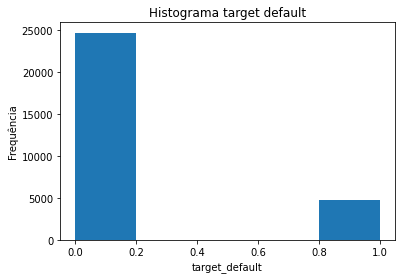

In [46]:
plt.hist(dimdim_clean_tmp['target_default'], bins=5)
plt.ylabel('Frequência')
plt.xlabel('target_default')
plt.title('Histograma target default')

In [47]:
profile = ProfileReport(dimdim_clean_tmp.head(300), title='DimDim', html={'style':{'full_width':True}})

In [48]:
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Na atual análise conseguimos verificar que a correlação das variáveis com a target parece não ser muito forte, porém iremos fazer mais algumas análises para determinar se isso é de fato um problema.

In [49]:
from biokit.viz import corrplot

Creating directory /root/.config/biokit 
Creating directory /root/.config/bioservices 


Computing correlation


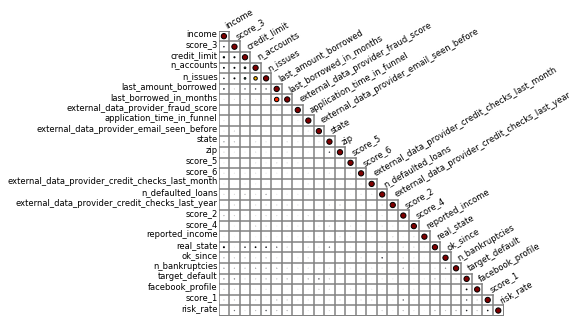

In [50]:
c = corrplot.Corrplot(dimdim_clean_tmp)
plt.rcParams['figure.figsize'] = (8,6)
c.plot(colorbar=False, method='circle', cmap='jet', shrink=.5, rotation=30, lower='circle')

plt.rcParams['figure.figsize'] = (6.4, 4.8)

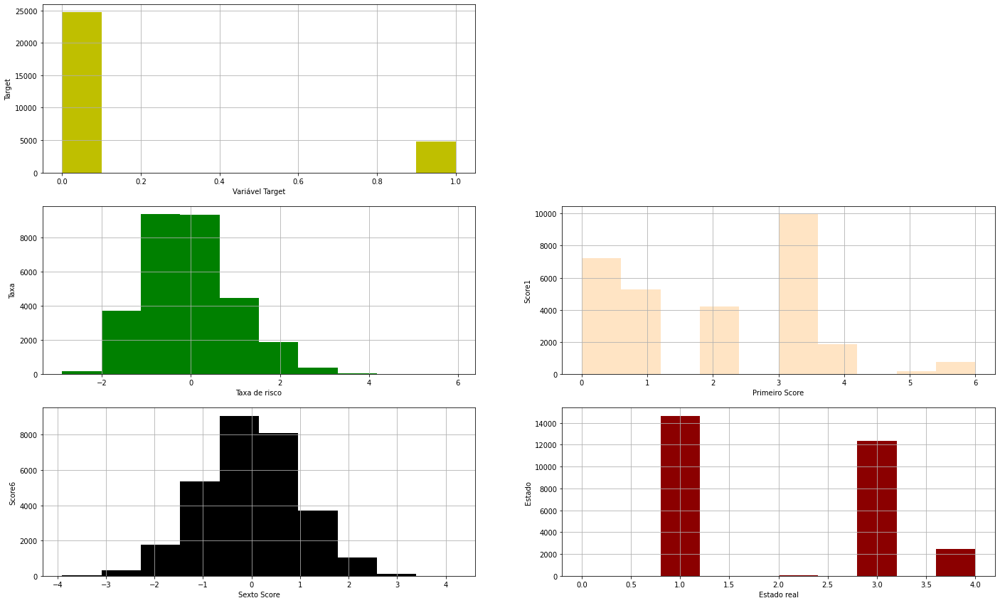

In [51]:
plt.figure(figsize=(24,20))

plt.subplot(4, 2, 1)
fig = dimdim_clean_tmp['target_default'].hist(color='y')
fig.set_xlabel('Variável Target')
fig.set_ylabel('Target')

plt.subplot(4, 2, 3)
fig = dimdim_clean_tmp['risk_rate'].hist(color='g')
fig.set_xlabel('Taxa de risco')
fig.set_ylabel('Taxa')

plt.subplot(4, 2, 4)
fig = dimdim_clean_tmp['score_1'].hist(color='bisque')
fig.set_xlabel('Primeiro Score')
fig.set_ylabel('Score1')

plt.subplot(4, 2, 5)
fig = dimdim_clean_tmp['score_6'].hist(color='black')
fig.set_xlabel('Sexto Score')
fig.set_ylabel('Score6')

plt.subplot(4, 2, 6)
fig = dimdim_clean_tmp['real_state'].hist(color='darkred')
fig.set_xlabel('Estado real')
fig.set_ylabel('Estado')

plt.show()

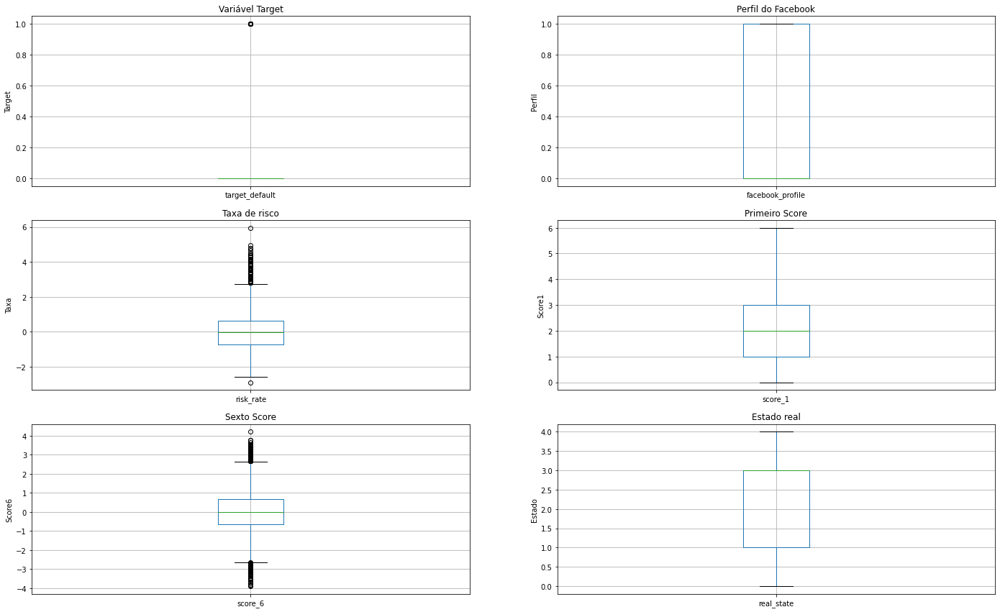

In [52]:
plt.figure(figsize=(24,20))

plt.subplot(4, 2, 1)
fig = dimdim_clean_tmp.boxplot(column='target_default')
fig.set_title('Variável Target')
fig.set_ylabel('Target')

plt.subplot(4, 2, 2)
fig = dimdim_clean_tmp.boxplot(column='facebook_profile')
fig.set_title('Perfil do Facebook')
fig.set_ylabel('Perfil')

plt.subplot(4, 2, 3)
fig = dimdim_clean_tmp.boxplot(column='risk_rate')
fig.set_title('Taxa de risco')
fig.set_ylabel('Taxa')

plt.subplot(4, 2, 4)
fig = dimdim_clean_tmp.boxplot(column='score_1')
fig.set_title('Primeiro Score')
fig.set_ylabel('Score1')

plt.subplot(4, 2, 5)
fig = dimdim_clean_tmp.boxplot(column='score_6')
fig.set_title('Sexto Score')
fig.set_ylabel('Score6')

plt.subplot(4, 2, 6)
fig = dimdim_clean_tmp.boxplot(column='real_state')
fig.set_title('Estado real')
fig.set_ylabel('Estado')

plt.show()

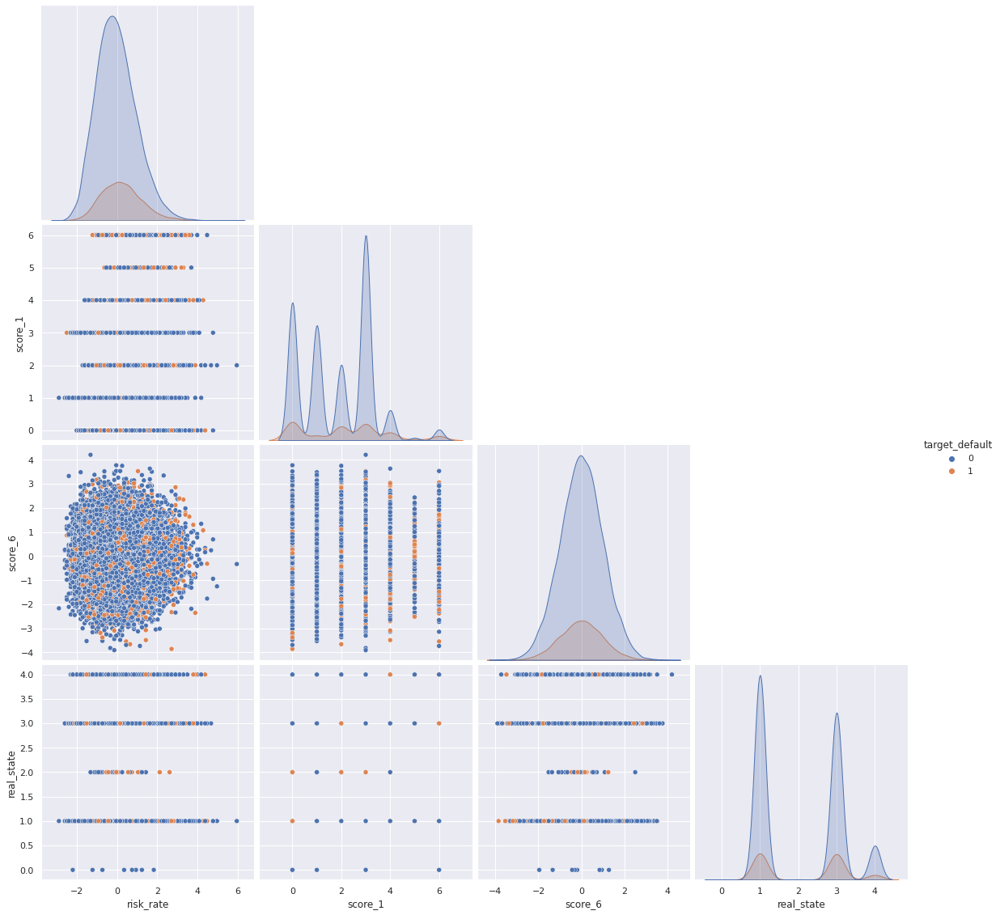

In [53]:
plt.close()
sns.set()
cols = ['target_default', 'risk_rate', 'score_1', 'score_6', 'real_state']
sns.pairplot(dimdim_clean_tmp[cols], height = 4,  hue="target_default", corner=True)
plt.show()
plt.close()

Após nossas análises gráficas, chegamos a alguns insights:

*   Existe uma correlação fraca entre as variáveis e a variável alvo
*   Algumas variáveis inesperadas para verificar a inadimplência influência fortemente o limite de crédito.
*   O número de empréstimos anteriores inadimplentes influência no limite de crédito.
*   Antes nós acreditavamos que se a pessoa ganhar mais salário teria mais limite de crédito, porém agora acreditamos que isso não tem relação.



## Escolha do modelo

Agora que já realizamos diversas análises em nossa base resolvemos então realizar o teste de uma família de altoritmos para que possamos então escolher um algoritmo mais adequado para a predissão do dataframe DimDim.

Para o nosso teste usaremos algumas famílias diferentes e comparamos a pontuação dos algoritmos utilizando a técnica AUC (O AUC representa o grau ou medida de separabilidade. Quanto maior o AUC, melhor o modelo está em prever 0s como 0s e 1s como 1s.). Além disso retornamos o teste de desvio-padrão, usando uma validação cruzada do tipo k-fold, para determinar o melhor algoritmo.

In [54]:
X = pd.concat([X_train, X_test]) # Concatenamos os X de treino com o teste
y = pd.concat([y_train, y_test]) # Concatenamos os Y de treino com o teste

In [55]:
# Teste de seleção de modelo
from sklearn import model_selection

# Importação dos algoritmos
from sklearn.dummy import DummyClassifier # Algotirmo de classificação fictício
from sklearn.tree import DecisionTreeClassifier # Algoritmo de árvore de decisão
from sklearn.neighbors import (KNeighborsClassifier) # Algoritmo classificador de vizinhos K
from sklearn.naive_bayes import GaussianNB # Algoritmo de Classificação Naive Bayes
from sklearn.svm import SVC # Algoritmo de classificação de vetores de suporte
from sklearn.ensemble import (RandomForestClassifier) # Algoritmo de floresta aleatória
import xgboost # Algoritmo Xgboost

In [56]:
for model in [
    DummyClassifier,
    DecisionTreeClassifier,
    KNeighborsClassifier,
    GaussianNB,
    SVC,
    RandomForestClassifier,
    xgboost.XGBClassifier,
]:
    cls = model()
    kfold = model_selection.KFold(n_splits=10, random_state=42, shuffle=True)
    s = model_selection.cross_val_score(
        cls, X, y, scoring="roc_auc", cv=kfold
    )
    print(
        f"{model.__name__:22}  AUC: "
        f"{s.mean():.2f} STD: {s.std():.2f}"
    )

DummyClassifier         AUC: 0.50 STD: 0.00
DecisionTreeClassifier  AUC: 0.55 STD: 0.01
KNeighborsClassifier    AUC: 0.54 STD: 0.01
GaussianNB              AUC: 0.65 STD: 0.02
SVC                     AUC: 0.50 STD: 0.02
RandomForestClassifier  AUC: 0.68 STD: 0.02
XGBClassifier           AUC: 0.71 STD: 0.02


Em nossa análise o algoritmo que teve um bom desempenho é: **XGBClassifier**, porém sabemos que isso é apenas um teste que pode ajudar na decisão e não de que realmente esse é o melhor algoritmo. 

Reparamos que o algoritmo **RandomForestClassifier** tem uma pontuação AUC boa, porém nós vamos escolher o modelo `XGBClassifier` por ter uma pontuação melhor e ter o mesmo erro padrão do `RandomForestClassifier`.

In [57]:
predictors = X_train.columns
predictors

Index(['score_1', 'score_2', 'score_3', 'score_4', 'score_5', 'score_6',
       'risk_rate', 'last_amount_borrowed', 'last_borrowed_in_months',
       'credit_limit', 'income', 'facebook_profile', 'state', 'zip',
       'real_state', 'ok_since', 'n_bankruptcies', 'n_defaulted_loans',
       'n_accounts', 'n_issues', 'application_time_in_funnel',
       'external_data_provider_credit_checks_last_month',
       'external_data_provider_credit_checks_last_year',
       'external_data_provider_email_seen_before',
       'external_data_provider_fraud_score', 'reported_income'],
      dtype='object')

A seguir nós executamos um segundo teste chamado stacking, o classificador stacking utiliza a saída de outros modelos para fazer a predição de um objetivo ou de um rótulo.

In [58]:
from sklearn.ensemble import RandomForestClassifier, StackingClassifier ## Importação do classificador Stacking

In [59]:
base_learners = [
    ('algo_1', xgboost.XGBClassifier()), 
    ('algo_2', DecisionTreeClassifier()),
    ('algo_3', KNeighborsClassifier()),
    ('algo_4', GaussianNB()),
    ('algo_5', SVC()),
    ('algo_6', RandomForestClassifier())
]

clf = StackingClassifier(estimators=base_learners, final_estimator=xgboost.XGBClassifier())

X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.3, random_state=42)
clf.fit(X_train, y_train).score(X_test, y_test)

0.8400679117147708

Reparemos que em nosso teste o desempenho melhorou. Aqui nós verificamos eficiência do nosso modelo `XGBClassifier` e realmente ao que tudo indica parece que o melhor modelo é o `XGBClassifier`.

Na sequência então nós iremos verificar a acurácia do nosso modelo para então tormar a decisão final de que este é um bom modelo.

In [60]:
from sklearn.model_selection import RepeatedStratifiedKFold
from numpy import mean
from numpy import std

In [61]:
model = xgboost.XGBClassifier()

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
n_scores = cross_val_score(model, X, y, scoring='accuracy', cv=cv, n_jobs=-1)

In [62]:
print('Accuracy: %.3f (%.3f)' % (mean(n_scores), std(n_scores)))

Accuracy: 0.841 (0.002)


Escolhemos o modelo `XGBClassifier`, porém vamos usar o algoritmo `RandomForest` só para realizar uma pequena análise da importância dos nossos atributos.

In [63]:
from sklearn import (
    ensemble
)

In [64]:
rf = ensemble.RandomForestClassifier(
    n_estimators=100, random_state=42
)

In [65]:
rf.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [66]:
rf.score(X_test, y_test)

0.8392756083757782

In [67]:
metrics.precision_score(
    y_test, rf.predict(X_test)
)

0.5161290322580645

In [68]:
for col, val in sorted(
    zip(
        X_train.columns,
        rf.feature_importances_,
    ),
    key=lambda x: x[1],
    reverse=True,
)[:5]:
    print(f"{col:10}{val:10.2f}")

income          0.07
application_time_in_funnel      0.07
score_6         0.06
score_4         0.06
score_5         0.06


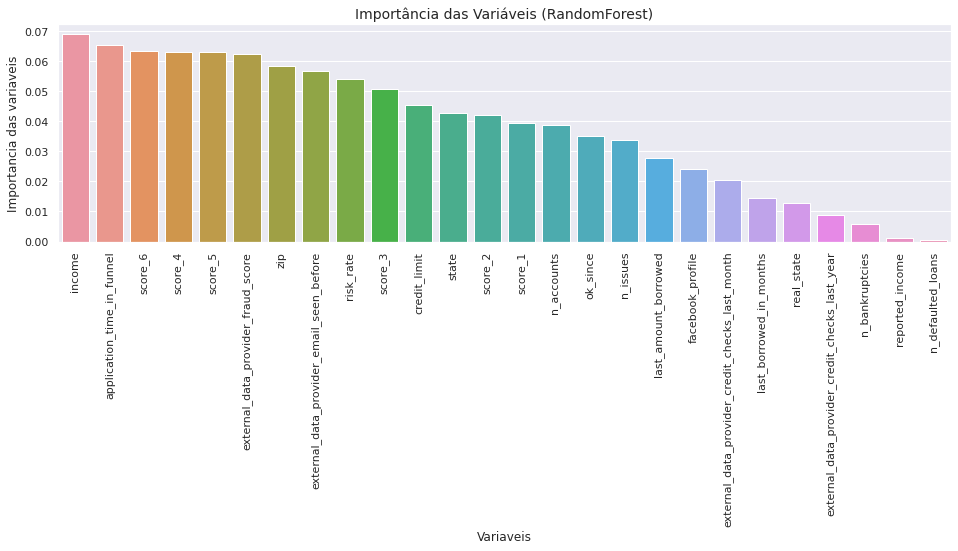

In [69]:
tmp = pd.DataFrame({'Variaveis': predictors, 'Importancia das variaveis': rf.feature_importances_})
tmp = tmp.sort_values(by='Importancia das variaveis', ascending=False)
plt.figure(figsize=(16,4))
plt.title('Importância das Variáveis (RandomForest)', fontsize=14)
s = sns.barplot(x='Variaveis', y='Importancia das variaveis', data=tmp)
s.set_xticklabels(s.get_xticklabels(),rotation=90)
plt.show()

### Decisão por XGboost

Após nossa análise podemos observar que o XGBoost é que apresentou a melhor acurácia, sendo assim, seguiremos com este modelo. Ajustamos o hyper parâmetro do nosso modelo.

In [70]:
def fpreproc(dtrain):
    ratio = float((dtrain.values== 0).sum() / (dtrain.values == 1).sum())
    return (print("Ajuste o hyper parametro scale_pos_weight para {}". format(ratio)))

fpreproc(y_train)

Ajuste o hyper parametro scale_pos_weight para 5.210906899668575


### Criação do modelo

Criamos o nosso modelo e na sequência faremos algumas validações para determinar a qualidade.

In [71]:
final_model = xgboost.XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.1, gamma=1,
              learning_rate=0.05, max_delta_step=0, max_depth=5,
              min_child_weight=1, missing=None, n_estimators=500, n_jobs=1,
              nthread=None, objective='binary:logistic', random_state=42,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=5.187141004261627, seed=None,
              silent=None, subsample=0.9, verbosity=1)

In [72]:
scores = cross_val_score(final_model, X_train, y_train, cv=10, scoring='roc_auc', n_jobs=-1)

In [73]:
scores

array([0.70298767, 0.71830733, 0.71897242, 0.71998398, 0.68146185,
       0.70349704, 0.71229626, 0.7207732 , 0.71971489, 0.70574083])

In [75]:
print("ROC_AUC = {:.2%}\n". format(scores.mean()))

ROC_AUC = 71.04%



In [76]:
final_model.fit(X_train, y_train, eval_metric='auc')

XGBClassifier(colsample_bytree=0.1, gamma=1, learning_rate=0.05, max_depth=5,
              n_estimators=500, random_state=42,
              scale_pos_weight=5.187141004261627, subsample=0.9)

### Matriz de confusão

A partir da matriz nós podemos ver as classificações corretas, bem como os falso-positivos e os falso-negativos e com isso nós conseguimos visualizar o desempenho do nosso algoritmo de classificação

In [77]:
from sklearn.metrics import confusion_matrix

In [79]:
y_pred = final_model.predict(X_test)
confusion_matrix(y_test, y_pred)

array([[5376, 2037],
       [ 601,  821]])

A seguir exibiremos um gráfico da matriz de confusão que foi montada anteriormente

In [89]:
from yellowbrick.classifier import (
    ConfusionMatrix,
    ROCAUC
)

/usr/local/lib/python3.7/dist-packages/yellowbrick/classifier/base.py:234: YellowbrickWarning: could not determine class_counts_ from previously fitted classifier
  YellowbrickWarning,


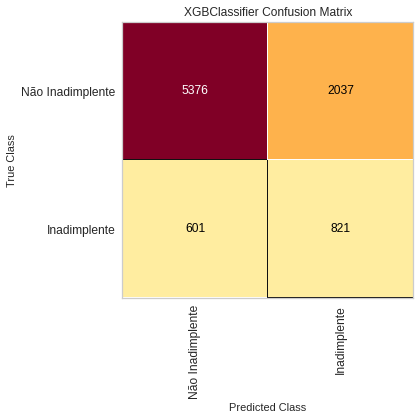

In [84]:
mapping = {0: "Não Inadimplente", 1: "Inadimplente"}
fig, ax = plt.subplots(figsize=(6, 6))
cm_viz = ConfusionMatrix(
    final_model,
    classes=["Não Inadimplente", "Inadimplente"],
    label_encoder=mapping,
)
cm_viz.score(X_test, y_test)
cm_viz.poof()

### Curva ROC

Executamos também o gráfico ROC (Características operacionais do receptor), que serve para avaliar os nossos classificadores

In [87]:
from sklearn.metrics import (
    roc_auc_score
)

In [88]:
y_pred = final_model.predict(X_test)
roc_auc_score(y_test, y_pred)

0.6512841507193713

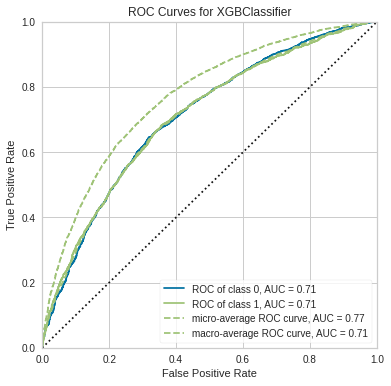

In [90]:
fig, ax = plt.subplots(figsize=(6, 6))
roc_viz = ROCAUC(final_model)
roc_viz.fit(X_train, y_train)
roc_viz.score(X_test, y_test)
roc_viz.poof()

Aqui podemos ver a taxa dos positivos em relação à taxa dos falso-positivos. Aqui no gráfico nós percebemos que o valor está próximo a 1(um), sendo assim conseguimos garantir que nosso modelo está adequado.

### Teste final

Agora já podemos exportar nosso modelo e utilizar para realizar a predição de clientes inadimplentes da Dim Dim.

In [95]:
import pickle

def dumpModel(model, filename):
  pickle.dump(model, open(filename, 'wb'))

In [96]:
X_test.columns

Index(['score_1', 'score_2', 'score_3', 'score_4', 'score_5', 'score_6',
       'risk_rate', 'last_amount_borrowed', 'last_borrowed_in_months',
       'credit_limit', 'income', 'facebook_profile', 'state', 'zip',
       'real_state', 'ok_since', 'n_bankruptcies', 'n_defaulted_loans',
       'n_accounts', 'n_issues', 'application_time_in_funnel',
       'external_data_provider_credit_checks_last_month',
       'external_data_provider_credit_checks_last_year',
       'external_data_provider_email_seen_before',
       'external_data_provider_fraud_score', 'reported_income'],
      dtype='object')

In [97]:
filename = 'dimdim_classifier.sav'

dumpModel(final_model, filename) # Aqui exportamos o nosso modelo para utilizar por exemplo no: Flask

### Teste do arquivo exportado

Fizemos um teste para garantir que está tudo correto com a execução do nosso modelo e também utiilzamos `roc_auc_score` para verificar o score do modelo.

In [98]:
loaded_model = pickle.load(open(filename, 'rb'))
y_pred = loaded_model.predict(X_test)

result = roc_auc_score(y_test, y_pred)

print(
    f'Pontuação do AUC: ' + \
    f'{result*100:.2f}'
)

Pontuação do AUC: 65.13


Exibição das predições da base de clientes.

In [99]:
y_pred

array([0, 0, 1, ..., 1, 0, 0])